In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from operator import itemgetter
import pandas as pd
import os
import glob
from PIL import Image

from mpl_toolkits.mplot3d import Axes3D

from numpy import exp
from numpy import sqrt
from numpy import cos
from numpy import e
from numpy import pi

In [ ]:
def g(v):
    return ((v[0]**2 + v[1]**2)/4000) - (cos(v[0]/np.sqrt(2))* cos(v[1]/np.sqrt(3))) + 1

X, Y = np.meshgrid(np.linspace(-10, 10, 100),
                   np.linspace(-10, 10, 100))
v_func = np.vectorize(g)
Z = g([X,Y]) 

In [62]:
# All definitions

def i_trg(x, y, c):
    x1 = x + c
    y1 = y
    x2 = x + c/2
    y2 = y + (c/2)*(3**(1/2))
    return list(zip(np.array([x,x1,x2]), np.array([y,y1,y2])))

def BGW(V, f):
    T = [(V[i], f(V[i])) for i in range(len(V)) ]
    return sorted(T, key=itemgetter(1))

def midpoint(o_trg, A=0, B=1):
    return ((o_trg[A][0][0] + o_trg[B][0][0])/2,
            (o_trg[A][0][1] + o_trg[B][0][1])/2)

def reflection(o_trg):
    M = midpoint(o_trg)
    W = o_trg[2][0]
    return (2*M[0] - W[0], 2*M[1] - W[1])

def expansion(o_trg):
    M = midpoint(o_trg)
    R = reflection(o_trg)
    return (2*R[0] - M[0], 2*R[1] - M[1])

def contraction(o_trg, f):
    M = midpoint(o_trg)
    R = reflection(o_trg)
    W = o_trg[2][0]
    insC = ((W[0] + M[0])/2, (W[1] + M[1])/2)
    outC = ((R[0] + M[0])/2, (R[1] + M[1])/2)
    return (insC, outC)

def shrink(o_trg, f):
    M, S  = midpoint(o_trg), midpoint(o_trg, A=0, B=2)
    return M, S

# Main function

def nelder_mead(o_trg, f, plot=False):
    # Creating DataFrame to store points location
    df = pd.DataFrame(columns=['index_plot','index_iter','Best_Point','Good_Point','Worst_Point'])
    for filenumber in range(1,4):
        # Setting random triangle coordinates 
        trg = i_trg(round(np.random.uniform(-7.5,7.5),2),round(np.random.uniform(-7.5,7.5),2),round(np.random.uniform(-7.5,7.5),2))
        o_trg = BGW(trg,g)
        print("k \t {:^20}   \t {:^20}   \t {:^20}".format("Best point", "Good point", "Worst point"))
        for i in range(0,15):
            
            if (i == 0):
                new_row = {'index_plot':filenumber,'index_iter':i, 'Best_Point':o_trg[0], 'Good_Point':o_trg[1],'Worst_Point':o_trg[2]}
                #append row to the dataframe
                df = df.append(new_row, ignore_index=True)   
                print("{} \t f({:.2f},{:.2f}) = {:.2f}   \t f({:.2f},{:.2f}) = {:.2f}   \t f({:.2f},{:.2f}) = {:.2f}"
                        .format(i+1, o_trg[0][0][0], o_trg[0][0][1], f(o_trg[0][0]),
                                o_trg[1][0][0], o_trg[1][0][1], f(o_trg[1][0]),
                                o_trg[2][0][0], o_trg[2][0][1], f(o_trg[2][0])))

                if plot:
                    bgw = np.array([o_trg[i][0] for i in range(len(o_trg))])
                    plt.clf()
                    plt.contour(X, Y, Z, levels = 20)
                    plt.plot((bgw[0,0], bgw[1,0]), (bgw[0,1], bgw[1,1]), '-b')
                    plt.plot((bgw[2,0], bgw[1,0]), (bgw[2,1], bgw[1,1]), '-b')
                    plt.plot((bgw[0,0], bgw[2,0]), (bgw[0,1], bgw[2,1]), '-b')
                    plt.plot(bgw[0,0], bgw[0,1], '.r')
                    plt.title('Iteration: Starting points',loc='center')
                    # Saving initial plot
                    path = '/Users/daniellilla/Desktop/Optimisation_Classes/All_plots/NelderMead_plots/'
                    files = os.listdir(path)
                    plt.savefig(path+files[filenumber]+'/'+f'plot.{i}.png', dpi = 300)
                    plt.show(block=False)
                    plt.pause(0.1)
            
            R = reflection(o_trg)
            G = o_trg[1][0]
            B = o_trg[0][0]
            
            if f(R) < f(G):
                # Case 1: reflection found a better point than Good point

                if f(B) < f(R):
                    # Case 1a: reflected point is not better than Best point -> replace Worst with R and end this iteration
                    
                    o_trg = BGW([B, G, R], f)              
                else:
                    # Case 1b: reflected point is better than Best point -> go even further (expansion)
                    
                    E = expansion(o_trg)
                    if f(E) < f(R):
                        # Case 1ba: expanded point is better than reflected point -> replace Worst with E and end this iteration
                        o_trg = BGW([B, G, E], f)
                    else:
                        # Case 1bb: expanded point is not better than reflected point -> replace Worst with R and end this iteration
                        o_trg = BGW([B, G, R], f)
            else:
                # Case 2: reflection found a worse point than Good point

                W = o_trg[2][0]
                if f(R) > f(W):
                    # Case 2a: reflected point is worse than Worst point -> perform inside contraction
                    C = contraction(o_trg, f)[0]
                else:
                    # Case 2b: reflected point is not worse than Worst point -> perform outside contraction
                    C = contraction(o_trg, f)[1]

                if f(C) < f(W):
                    # Case 3a: contraction worked -> replace Worst with C and end this iteration
                    o_trg = BGW([B, G, C], f)
                else:
                    # Case 3b: contraction did not work -> shrink the triangle
                    M, S = shrink(o_trg, f)
                    o_trg = BGW([B, M, S], f)
            
            new_row = {'index_plot':filenumber,'index_iter':i, 'Best_Point':o_trg[0], 'Good_Point':o_trg[1],'Worst_Point':o_trg[2]}
            #append row to the dataframe
            df = df.append(new_row, ignore_index=True)
            print("{} \t f({:.2f},{:.2f}) = {:.2f}   \t f({:.2f},{:.2f}) = {:.2f}   \t f({:.2f},{:.2f}) = {:.2f}"
                .format(i+1, o_trg[0][0][0], o_trg[0][0][1], f(o_trg[0][0]),
                        o_trg[1][0][0], o_trg[1][0][1], f(o_trg[1][0]),
                        o_trg[2][0][0], o_trg[2][0][1], f(o_trg[2][0])))
            
            if plot:
                bgw = np.array([o_trg[i][0] for i in range(len(o_trg))])
                plt.clf()
                plt.contour(X, Y, Z, levels = 20)
                plt.plot((bgw[0,0], bgw[1,0]), (bgw[0,1], bgw[1,1]), '-b')
                plt.plot((bgw[2,0], bgw[1,0]), (bgw[2,1], bgw[1,1]), '-b')
                plt.plot((bgw[0,0], bgw[2,0]), (bgw[0,1], bgw[2,1]), '-b')
                plt.plot(bgw[0,0], bgw[0,1], '.r')
                plt.title(f'Iteration: {i+1}',loc='center')
                # Saving further plots
                path = '/Users/daniellilla/Desktop/Optimisation_Classes/All_plots/NelderMead_plots/'
                files = os.listdir(path)
                plt.savefig(path+files[filenumber]+'/'+f'plot.{i+1}.png', dpi = 300)
                plt.show(block=False)
                plt.pause(0.1)
                
    plt.show()
                
    return o_trg,df

In [63]:
trg = i_trg(2,.5,1.5)
o_trg = BGW(trg,g)

k 	      Best point        	      Good point        	     Worst point     
1 	 f(1.09,-3.95) = 1.47   	 f(-0.74,-3.95) = 1.57   	 f(0.18,-5.53) = 2.00


/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:55: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


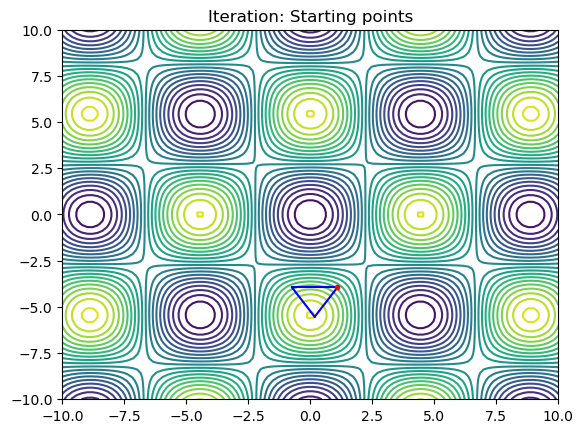

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


1 	 f(0.18,-0.78) = 0.11   	 f(1.09,-3.95) = 1.47   	 f(-0.74,-3.95) = 1.57


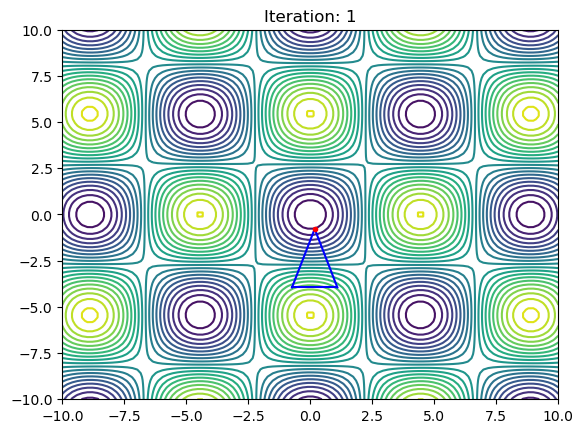

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


2 	 f(0.18,-0.78) = 0.11   	 f(2.00,-0.78) = 0.86   	 f(1.09,-3.95) = 1.47


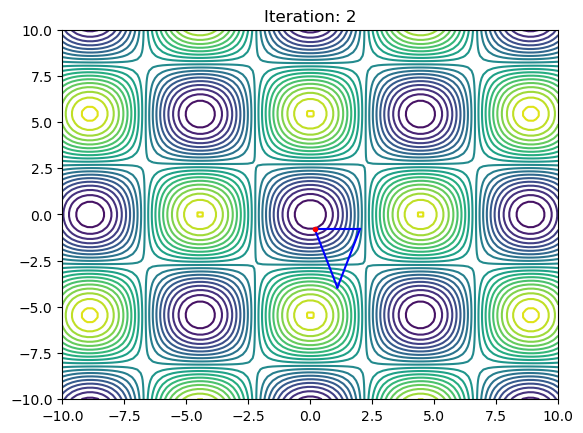

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


3 	 f(0.18,-0.78) = 0.11   	 f(1.09,0.80) = 0.36   	 f(2.00,-0.78) = 0.86


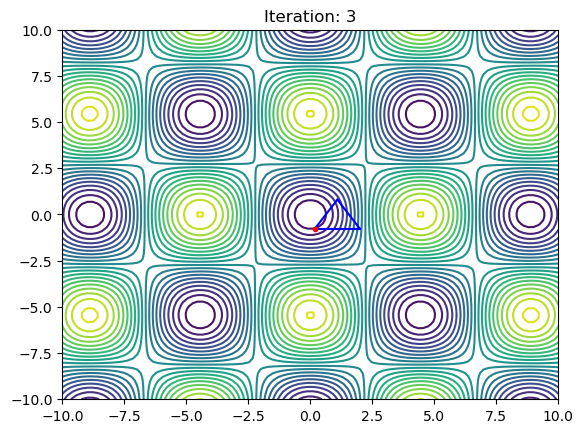

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


4 	 f(0.18,-0.78) = 0.11   	 f(-0.74,0.80) = 0.23   	 f(1.09,0.80) = 0.36


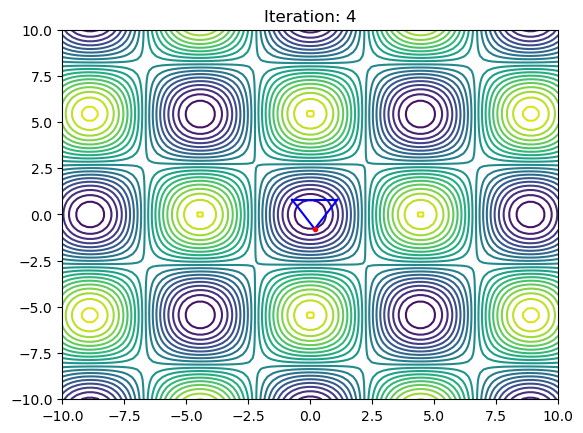

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


5 	 f(0.40,0.41) = 0.07   	 f(0.18,-0.78) = 0.11   	 f(-0.74,0.80) = 0.23


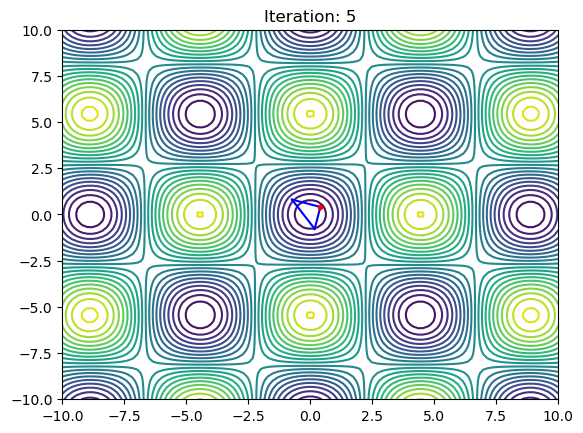

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


6 	 f(-0.23,0.31) = 0.03   	 f(0.40,0.41) = 0.07   	 f(0.18,-0.78) = 0.11


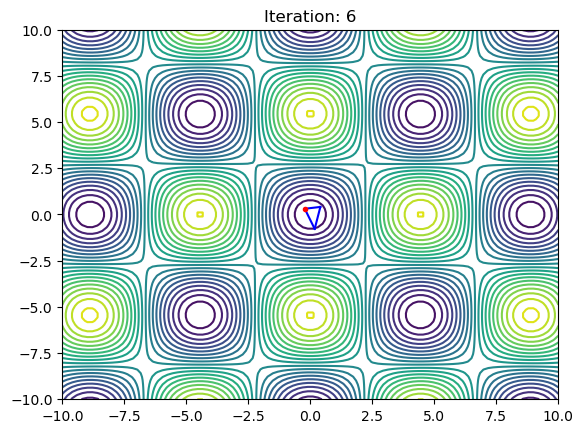

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


7 	 f(0.13,-0.21) = 0.01   	 f(-0.23,0.31) = 0.03   	 f(0.40,0.41) = 0.07


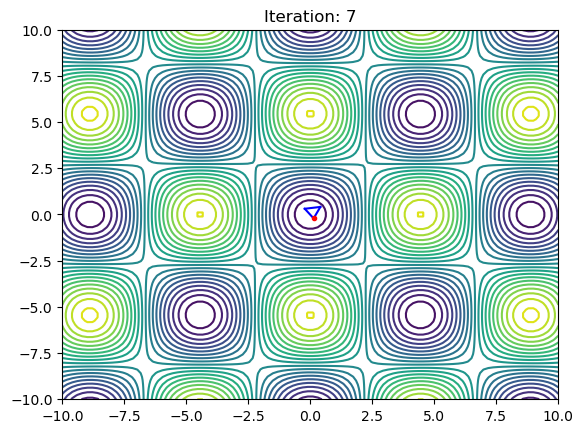

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


8 	 f(0.13,-0.21) = 0.01   	 f(0.18,0.23) = 0.02   	 f(-0.23,0.31) = 0.03


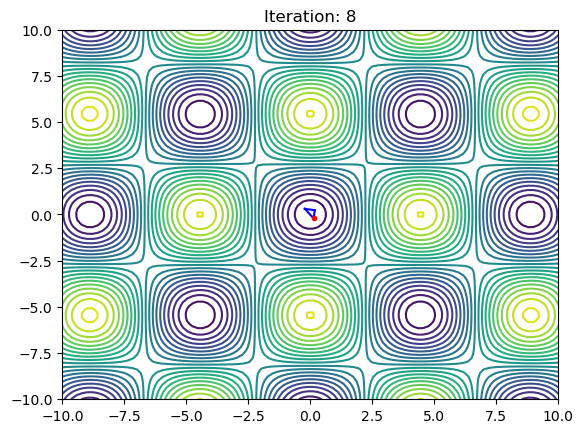

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


9 	 f(-0.03,0.16) = 0.00   	 f(0.13,-0.21) = 0.01   	 f(0.18,0.23) = 0.02


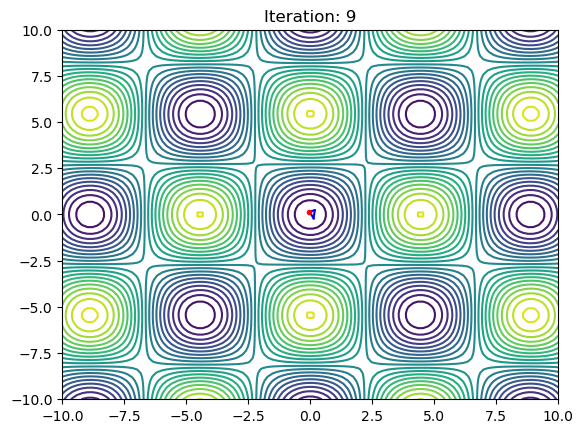

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


10 	 f(-0.02,-0.15) = 0.00   	 f(-0.03,0.16) = 0.00   	 f(0.13,-0.21) = 0.01


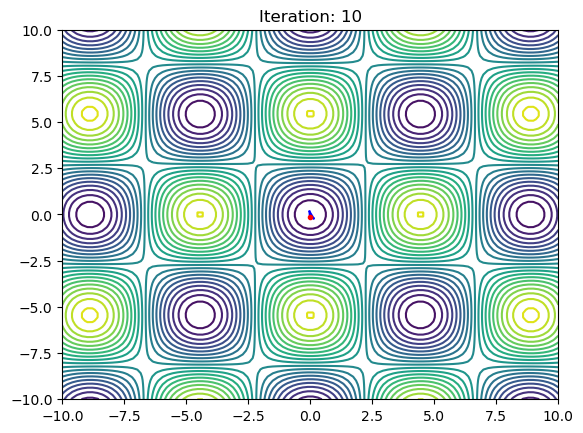

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


11 	 f(0.05,-0.10) = 0.00   	 f(-0.02,-0.15) = 0.00   	 f(-0.03,0.16) = 0.00


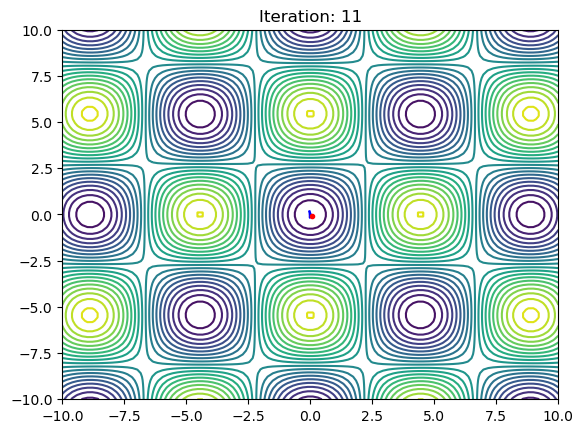

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


12 	 f(-0.01,0.02) = 0.00   	 f(0.05,-0.10) = 0.00   	 f(-0.02,-0.15) = 0.00


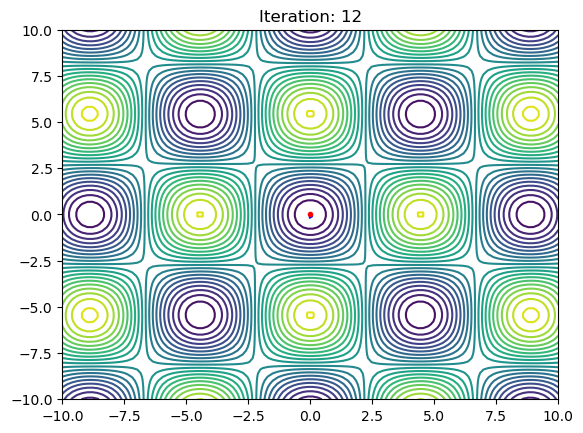

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


13 	 f(-0.01,0.02) = 0.00   	 f(0.06,0.06) = 0.00   	 f(0.05,-0.10) = 0.00


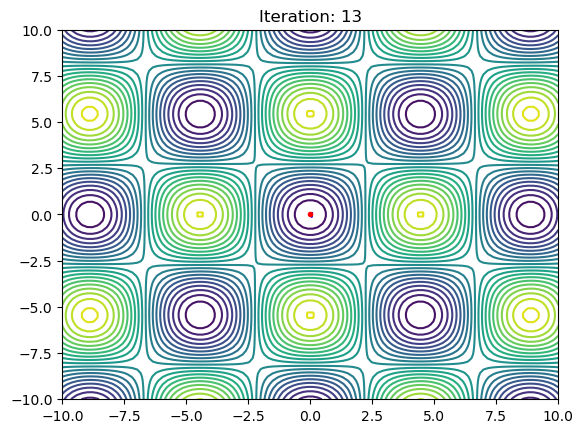

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


14 	 f(-0.01,0.02) = 0.00   	 f(0.04,-0.03) = 0.00   	 f(0.06,0.06) = 0.00


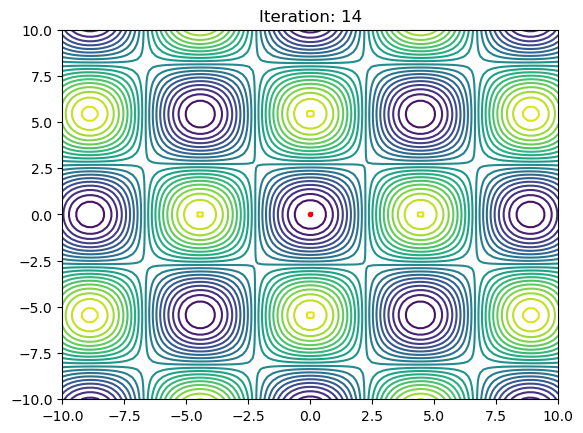

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


15 	 f(-0.01,0.02) = 0.00   	 f(-0.01,-0.04) = 0.00   	 f(0.04,-0.03) = 0.00


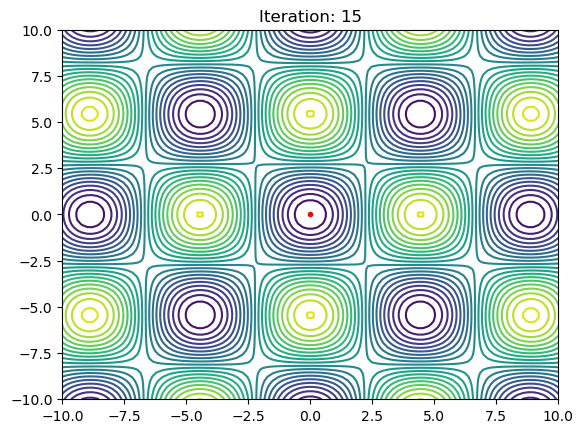

k 	      Best point        	      Good point        	     Worst point     
1 	 f(9.31,7.64) = 1.32   	 f(5.56,1.14) = 1.56   	 f(13.06,1.14) = 1.82


/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:55: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


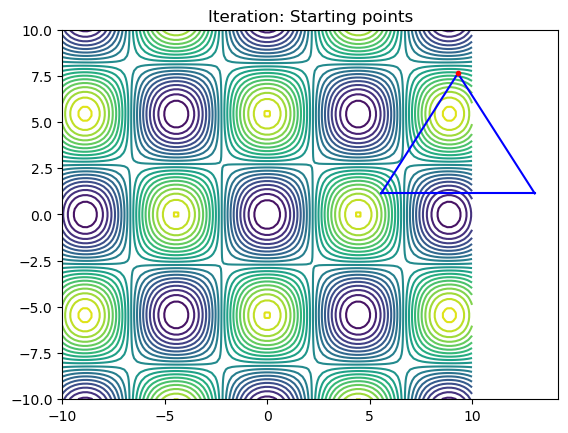

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


1 	 f(1.81,7.64) = 1.10   	 f(9.31,7.64) = 1.32   	 f(5.56,1.14) = 1.56


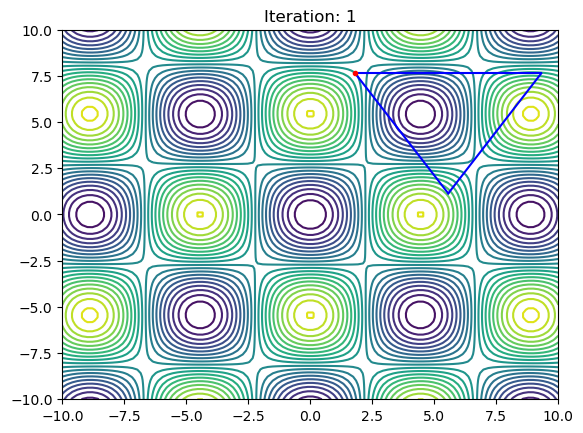

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


2 	 f(5.56,14.13) = 0.85   	 f(1.81,7.64) = 1.10   	 f(9.31,7.64) = 1.32


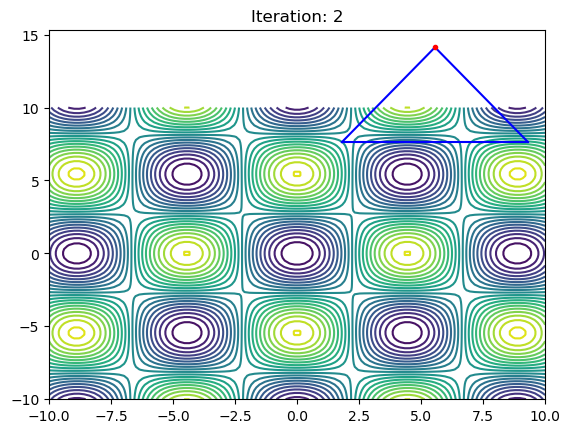

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


3 	 f(0.87,12.51) = 0.56   	 f(5.56,14.13) = 0.85   	 f(1.81,7.64) = 1.10


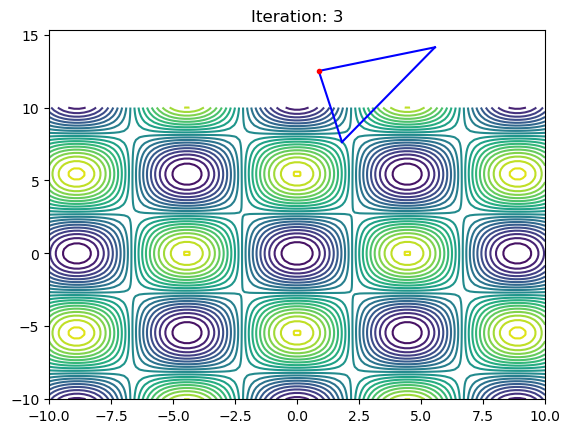

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


4 	 f(3.92,16.16) = 0.14   	 f(0.87,12.51) = 0.56   	 f(5.56,14.13) = 0.85


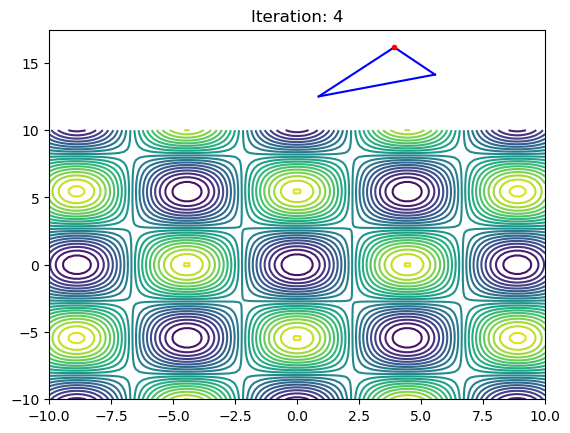

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


5 	 f(3.92,16.16) = 0.14   	 f(0.87,12.51) = 0.56   	 f(3.98,14.23) = 0.72


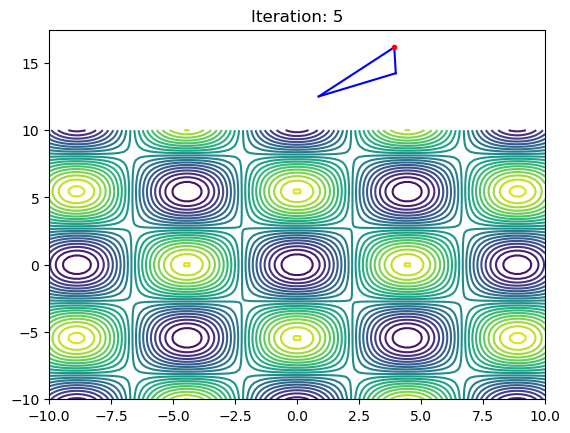

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


6 	 f(3.92,16.16) = 0.14   	 f(3.95,15.20) = 0.31   	 f(2.40,14.33) = 1.00


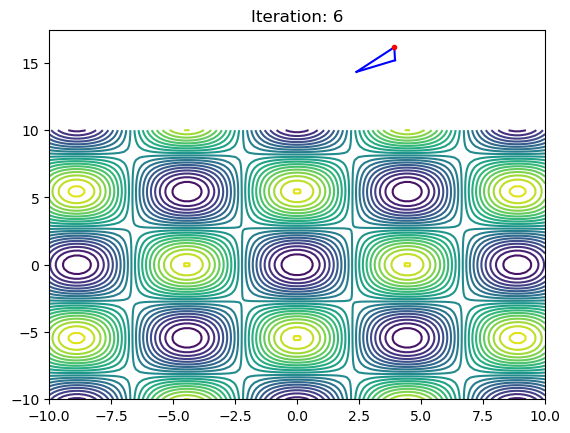

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


7 	 f(4.70,16.35) = 0.09   	 f(3.92,16.16) = 0.14   	 f(3.95,15.20) = 0.31


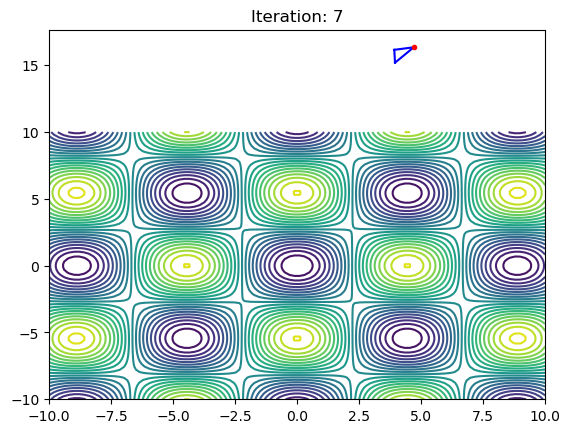

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


8 	 f(4.70,16.35) = 0.09   	 f(4.49,16.78) = 0.11   	 f(3.92,16.16) = 0.14


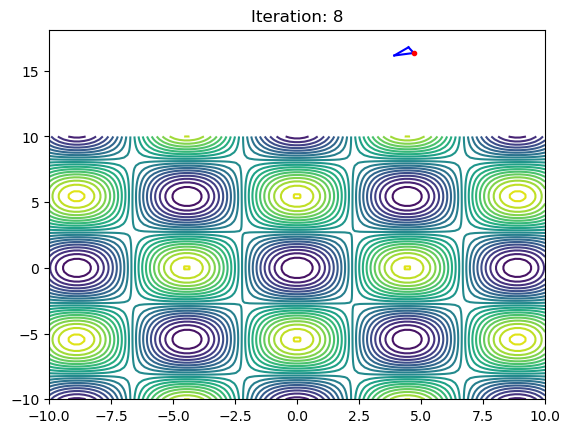

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


9 	 f(4.26,16.36) = 0.08   	 f(4.70,16.35) = 0.09   	 f(4.49,16.78) = 0.11


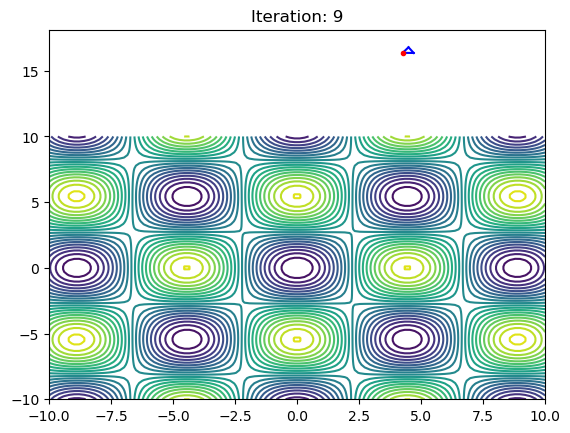

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


10 	 f(4.47,16.14) = 0.08   	 f(4.26,16.36) = 0.08   	 f(4.70,16.35) = 0.09


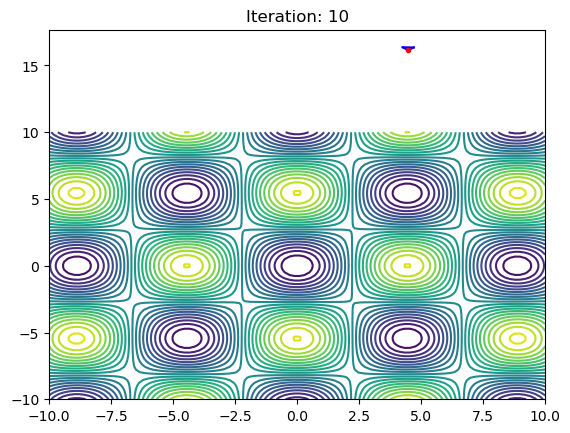

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


11 	 f(4.53,16.30) = 0.07   	 f(4.47,16.14) = 0.08   	 f(4.26,16.36) = 0.08


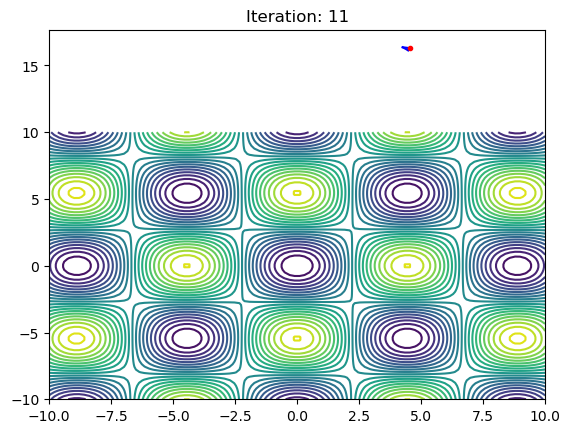

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


12 	 f(4.38,16.29) = 0.07   	 f(4.53,16.30) = 0.07   	 f(4.47,16.14) = 0.08


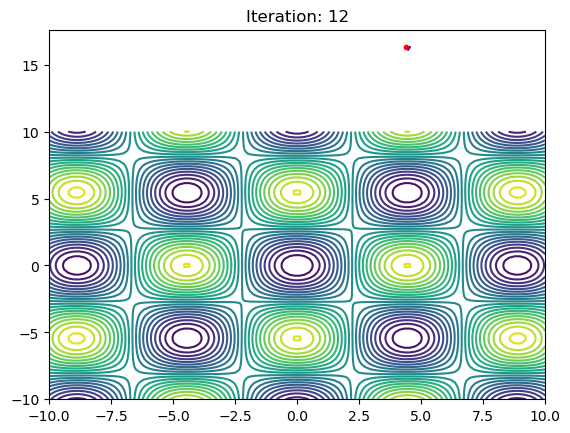

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


13 	 f(4.38,16.29) = 0.07   	 f(4.45,16.37) = 0.07   	 f(4.53,16.30) = 0.07


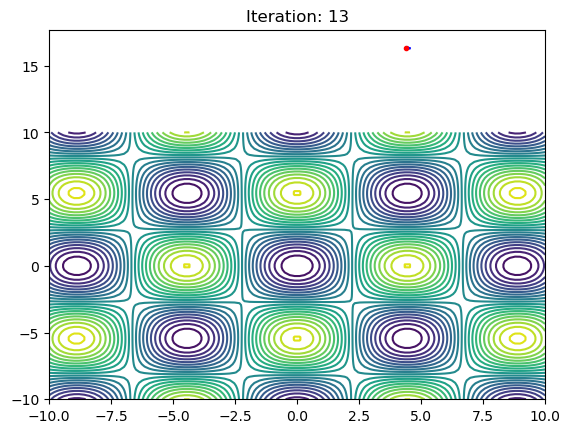

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


14 	 f(4.48,16.32) = 0.07   	 f(4.38,16.29) = 0.07   	 f(4.45,16.37) = 0.07


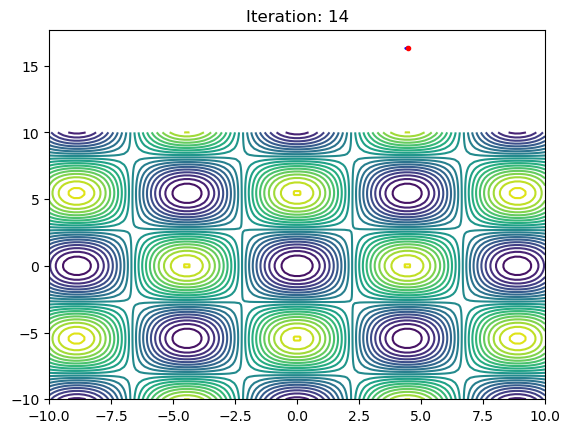

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


15 	 f(4.42,16.27) = 0.07   	 f(4.48,16.32) = 0.07   	 f(4.38,16.29) = 0.07


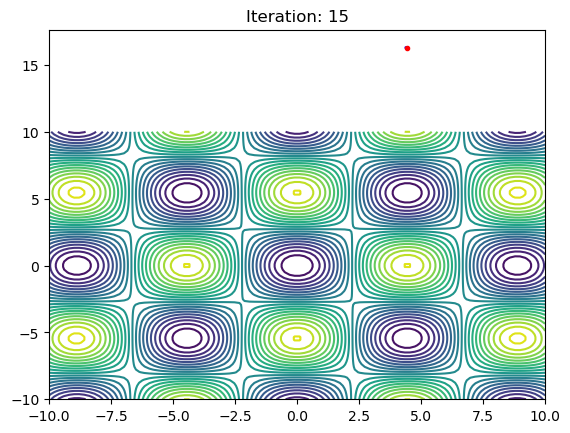

k 	      Best point        	      Good point        	     Worst point     
1 	 f(5.53,-4.17) = 0.48   	 f(5.22,-3.64) = 0.58   	 f(5.83,-3.64) = 0.73


/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:55: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


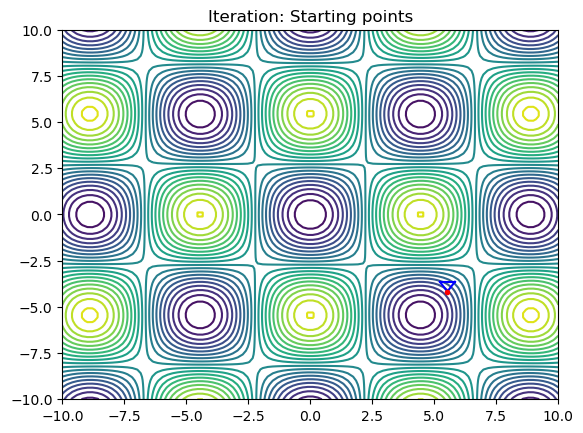

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


1 	 f(4.46,-4.43) = 0.17   	 f(5.53,-4.17) = 0.48   	 f(5.22,-3.64) = 0.58


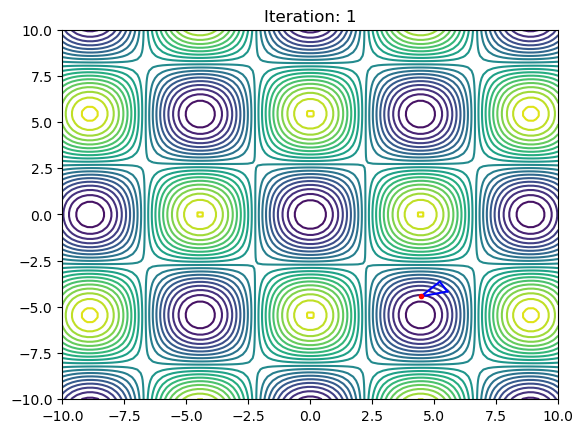

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


2 	 f(4.53,-5.62) = 0.02   	 f(4.46,-4.43) = 0.17   	 f(5.53,-4.17) = 0.48


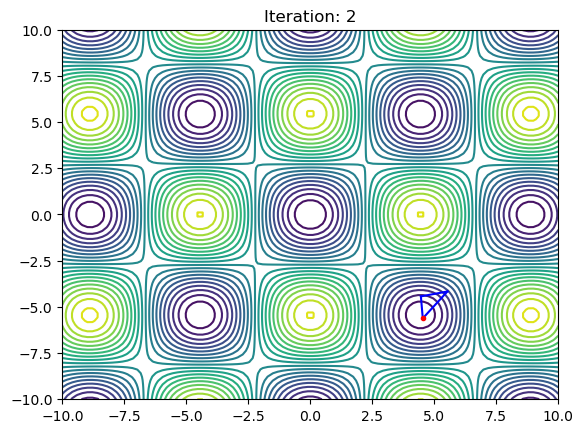

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


3 	 f(4.53,-5.62) = 0.02   	 f(3.98,-5.46) = 0.06   	 f(4.46,-4.43) = 0.17


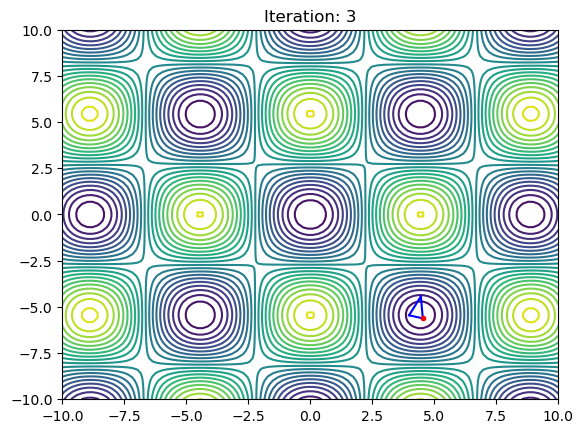

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


4 	 f(4.53,-5.62) = 0.02   	 f(4.36,-4.99) = 0.05   	 f(3.98,-5.46) = 0.06


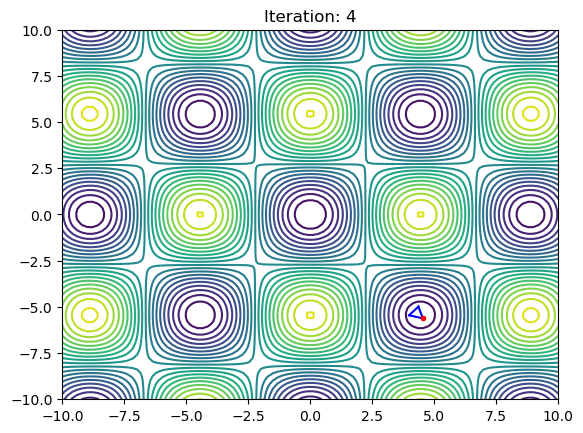

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


5 	 f(4.53,-5.62) = 0.02   	 f(4.21,-5.38) = 0.03   	 f(4.36,-4.99) = 0.05


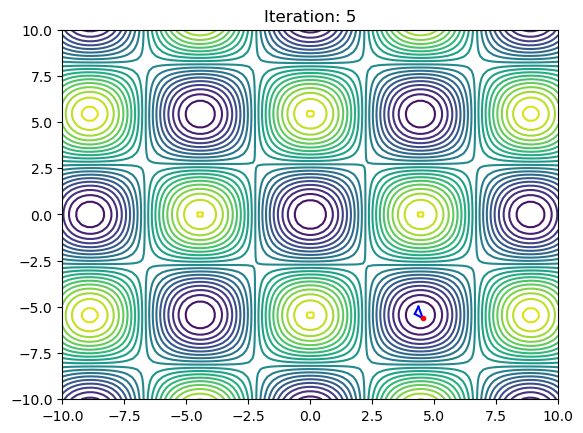

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


6 	 f(4.37,-5.24) = 0.02   	 f(4.53,-5.62) = 0.02   	 f(4.21,-5.38) = 0.03


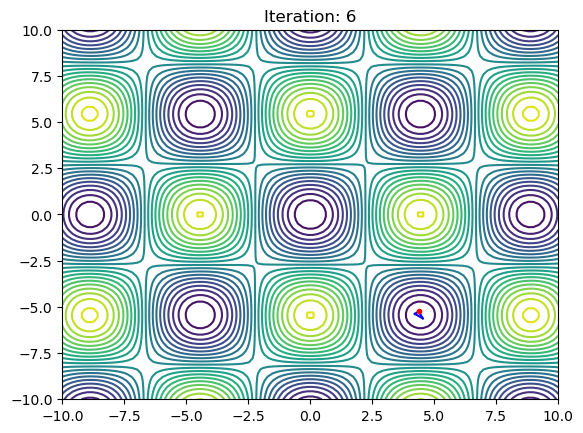

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


7 	 f(4.33,-5.41) = 0.02   	 f(4.37,-5.24) = 0.02   	 f(4.53,-5.62) = 0.02


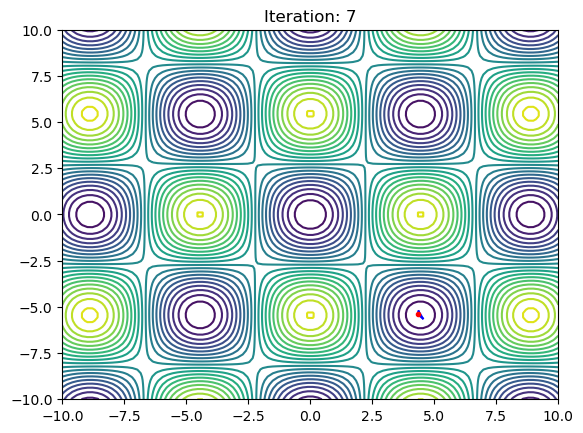

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


8 	 f(4.44,-5.47) = 0.01   	 f(4.33,-5.41) = 0.02   	 f(4.37,-5.24) = 0.02


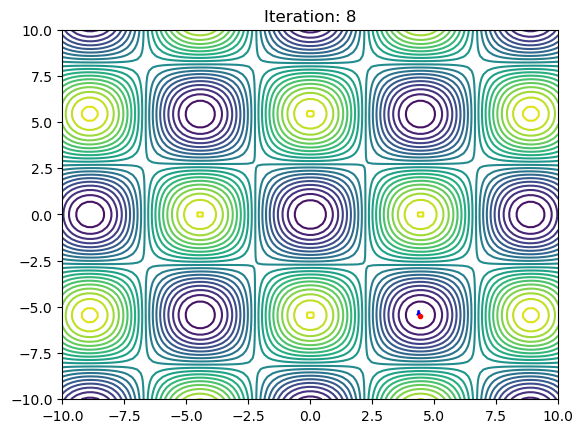

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


9 	 f(4.44,-5.47) = 0.01   	 f(4.40,-5.54) = 0.01   	 f(4.33,-5.41) = 0.02


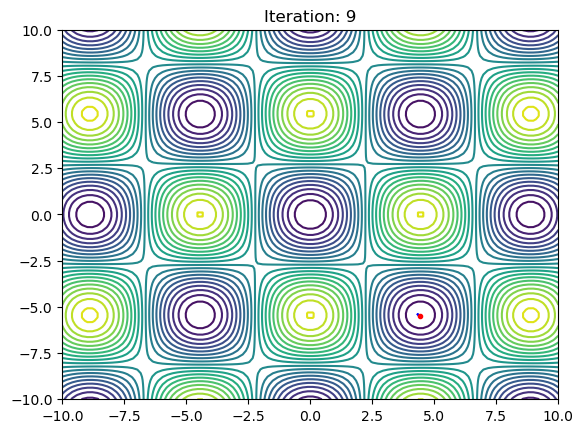

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


10 	 f(4.44,-5.47) = 0.01   	 f(4.38,-5.46) = 0.01   	 f(4.40,-5.54) = 0.01


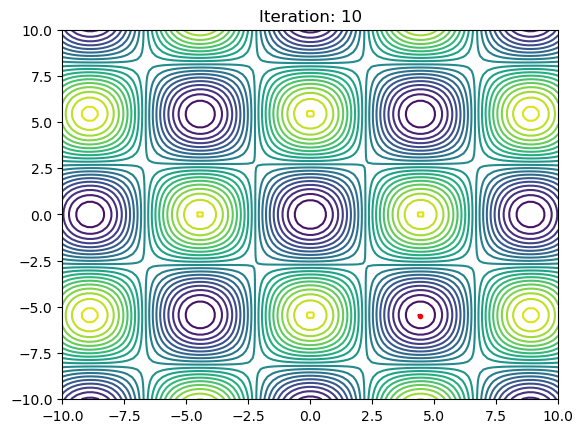

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


11 	 f(4.44,-5.47) = 0.01   	 f(4.42,-5.39) = 0.01   	 f(4.38,-5.46) = 0.01


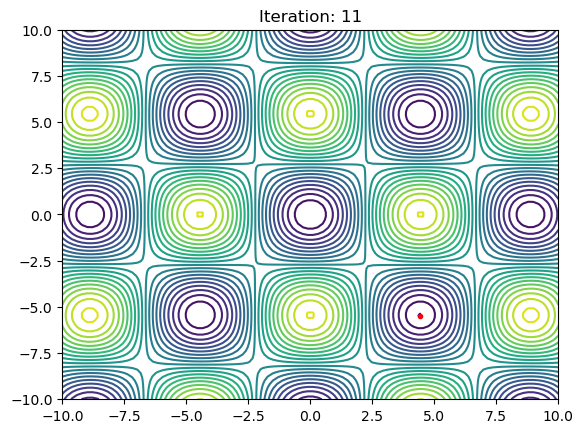

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


12 	 f(4.46,-5.42) = 0.01   	 f(4.44,-5.47) = 0.01   	 f(4.42,-5.39) = 0.01


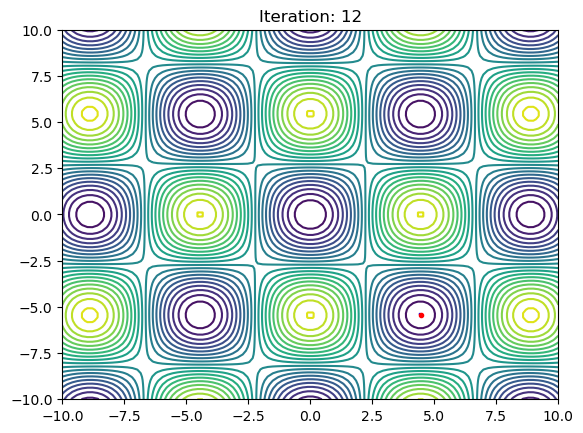

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


13 	 f(4.43,-5.42) = 0.01   	 f(4.46,-5.42) = 0.01   	 f(4.44,-5.47) = 0.01


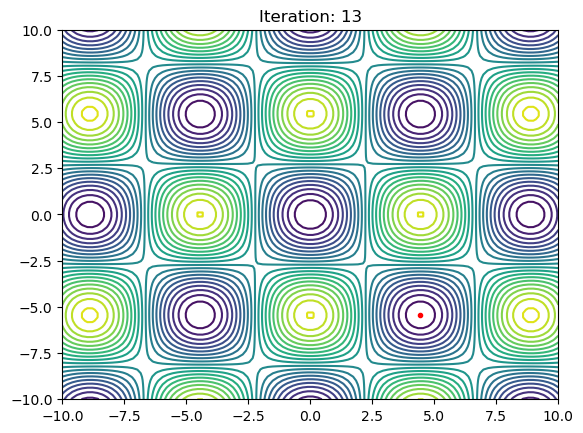

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


14 	 f(4.44,-5.45) = 0.01   	 f(4.43,-5.42) = 0.01   	 f(4.46,-5.42) = 0.01


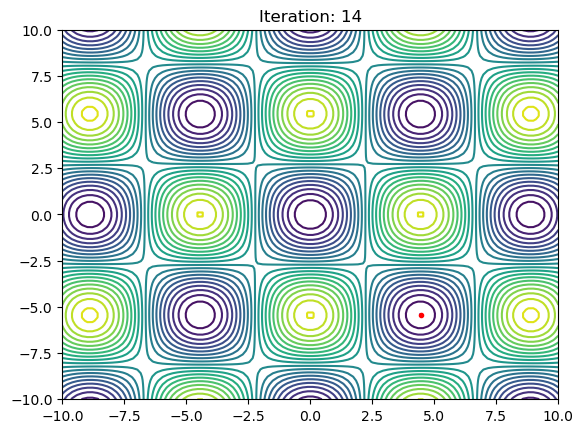

/var/folders/_4/h9l9tmt125scs2rqlyp5107c0000gn/T/ipykernel_96829/1591669296.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)


15 	 f(4.43,-5.44) = 0.01   	 f(4.44,-5.45) = 0.01   	 f(4.43,-5.42) = 0.01


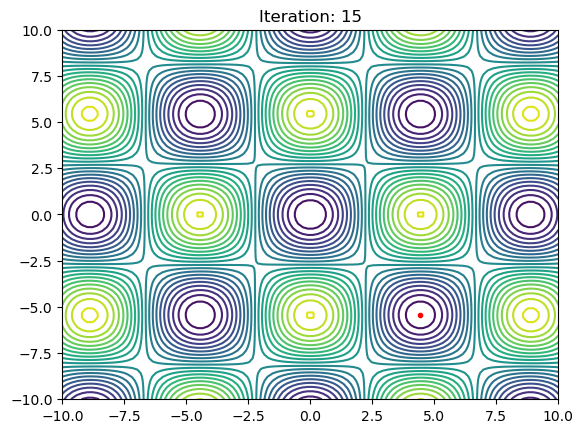

In [64]:
output = nelder_mead(o_trg,g,plot=True)

In [74]:
for i in range(1,4):
    path = '/Users/daniellilla/Desktop/Optimisation_Classes/All_plots/NelderMead_plots/'
    files = os.listdir(path)
    # Taking all png files downloaded
    extension = 'png'
    os.chdir(path+files[i])
    all_bay_plots = glob.glob('*.{}'.format(extension))
    sorted_files = sorted(all_bay_plots, key=lambda x: int(x.split('.')[1]))

    fp_out = f'/Users/daniellilla/Desktop/Optimisation_Classes/All_gifs/NelderMead_plots/Gif{i}.gif'

    imgs = (Image.open(picture) for picture in sorted_files)
    img = next(imgs)  # extract first image from iterator
    img.save(fp=fp_out, format='GIF', append_images=imgs,
            save_all=True, duration=500, loop=0)